<a href="https://colab.research.google.com/github/The-One-Program/FiNNiGAN-Implementation/blob/main/WFinniGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! git clone https://github.com/The-One-Program/FiNNiGAN-Implementation.git

Cloning into 'FiNNiGAN-Implementation'...
remote: Enumerating objects: 126, done.
remote: Counting objects: 100% (44/44), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 126 (delta 17), reused 21 (delta 7), pack-reused 82
Receiving objects: 100% (126/126), 79.30 MiB | 14.87 MiB/s, done.
Resolving deltas: 100% (49/49), done.


In [2]:
!pip install pytorch-msssim
import os
import cv2
import shutil # For Deleting the Non-Empty Directory fromo colab
from google.colab.patches import cv2_imshow
import torch 
import torch.nn as nn
import torch.optim as optim
import torchvision 
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter

%cd FiNNiGAN-Implementation

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/content/FiNNiGAN-Implementation


In [3]:
# Extracting The Frames:
VidDirectory = os.path.join('data','Videos') # --> os.path.join('data','Videos')
# Will be the absolute path:
Abs_DatasetPath = "/content/FiNNiGAN-Implementation/data/output/" # --> "C:/.../FiniGAN/data/output/"
#Will be a relative path:
Rel_DatasetPath = os.path.join('data','output') # --> os.path.join('data','output')

directory = os.fsencode(VidDirectory)


def saveFrame(success,img,dirname,name):
    if success:
        result=cv2.imwrite(Abs_DatasetPath+dirname+'/'+name,img)
        print(Abs_DatasetPath+dirname+'/'+name)
    if result==True:
        print('File saved successfully')
    else:
        print('Error in saving file')


cnt = -1
def VidCap(VidPath,count):
    cap = cv2.VideoCapture(VidPath)

    for frame_idx in range((int(cap.get(cv2.CAP_PROP_FRAME_COUNT))//3)*3):
        # Read Frame:
        success,frame = cap.read()
        global cnt 
        if((frame_idx%3)==0):
            cnt += 1
            dir_path = os.path.join(Rel_DatasetPath,'data'+str(cnt))
            
            # if os.path.exists(dir_path): # Set-ExecutionPolicy Unrestricted
            #     os.remove(dir_path) 
            """Above Removal Not working, reason is not clear"""
            
            # Create a directory as data_i: 
            os.mkdir(dir_path) 
            # Add current frame also to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame1.png')

        elif((frame_idx%3)==1):
            # Add current Frame to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame2.png')

        else:
            # Add current Frame to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame3.png')

        # Rendering The Processing Video
        # cv2_imshow(frame)
        if cv2.waitKey(10) & 0xFF == ord('q'):
            break

    # Close down Everything and release Video Writer:
    cap.release()
    cv2.destroyAllWindows()

os.listdir(directory)

[b'vid4.y4m',
 b'vid3.y4m',
 b'.ipynb_checkpoints',
 b'vid5.y4m',
 b'vid1.y4m',
 b'vid2.y4m',
 b'vid0.y4m']

In [4]:
# Iterating The Videos containing Directory
outcount = 0
for file in os.listdir(directory):
    filename = os.fsdecode(file)
    file_path = os.path.join(VidDirectory,filename)
    VidCap(file_path,outcount)
    print(filename)
    outcount+=1

vid4.y4m
/content/FiNNiGAN-Implementation/data/output/data0/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data0/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data0/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data3/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data3/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/

In [5]:
from model import Discriminator, UNET, initialize_weights
from FinniDataset import FinniGANDataset
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM
from utils import gradient_penalty

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

In [6]:
# Hyperparams:
Lr = 1e-3
Batch_size = 16
Image_size = 256 # To be taken Care of !!
Channel_img = 3
Num_Epochs = 32
CRITIC_ITERATIONS = 5
LAMBDA_GP = 10
Stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Appling the Transforms:
CustomTransform = transforms.Compose(
    [
        transforms.Resize((Image_size,Image_size)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(Channel_img)], [0.5 for _ in range(Channel_img)]
        )
    ]
)
# Load Data:
dataset = FinniGANDataset(root_dir = os.path.join('data', 'output'), transform=CustomTransform)
datalen = len(dataset)
print(datalen)
train_set, test_set = torch.utils.data.random_split(dataset, [int(0.8*datalen),datalen-int(0.8*datalen)])
train_loader = DataLoader(dataset=train_set, batch_size=Batch_size, shuffle=True)
test_loader = DataLoader(dataset=test_set, batch_size=Batch_size, shuffle=True)

# Initializing The Model:
gen = UNET(in_channels=3,out_channels=3).to(device)
critic = Discriminator(in_channels=3).to(device)
initialize_weights(gen)
initialize_weights(critic)

# Using different optimisers for gen and disc:
opt_gen = optim.Adam(gen.parameters(), lr=Lr, betas=(0.9, 0.999), eps=1e-08, weight_decay=0) # Betas Can be changed:
opt_disc = optim.Adam(critic.parameters(), lr=Lr, betas=(0.9, 0.999), eps=1e-08, weight_decay=0) # Betas Can be changed:

# Defining the Loss for Generator and Discriminator:
binary_cross_entropy = nn.BCELoss()
l1_loss = nn.L1Loss()
clipping_loss = nn.MSELoss()

# Telling the activation and other optimization layers to work:
gen.train()
critic.train()

284


Discriminator(
  (dis): Sequential(
    (0): Conv2d(3, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(8, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2)
    (12): Conv2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(1, eps=1e-05, momentum=0.1, affine=True, track_running_st

In [7]:
def denorm(img_tensor):
    return img_tensor*Stats[1][0] + Stats[0][0]

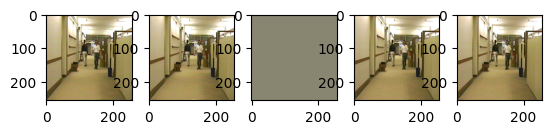

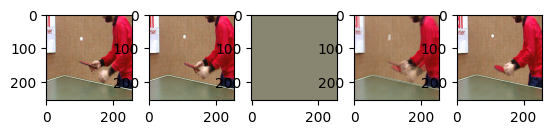

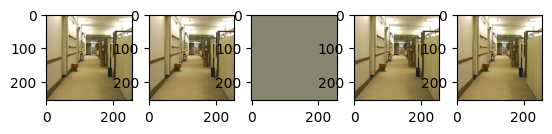

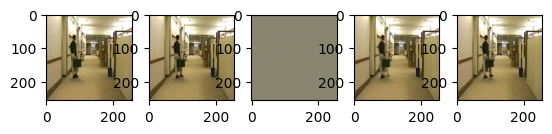

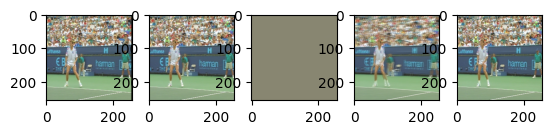

...

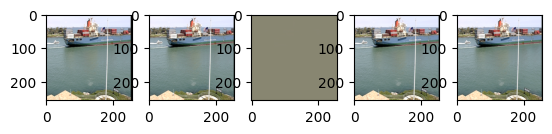

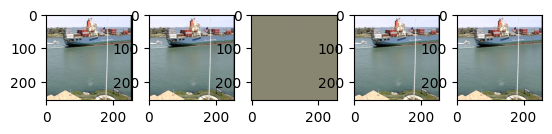

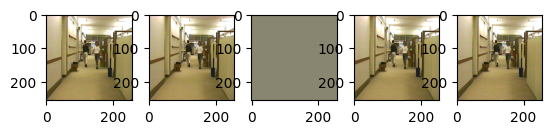

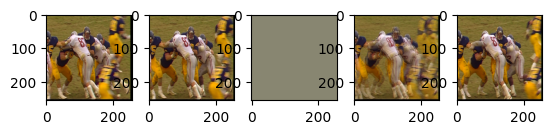

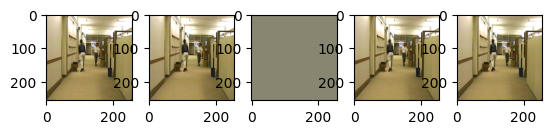

In [8]:
def showImg(idx):
    t1,t2,Img1,Img2 = test_set[idx]
    t1.to(device)
    t2.to(device)
    Img1.to(device)
    Img2.to(device)
    T1 = torch.unsqueeze(t1,dim=0).to(device)

    genout = gen(T1).to(device)
    genout = torch.squeeze(genout,dim=0).to(device)

    f , axarr = plt.subplots(1,5)
    axarr[0].imshow(denorm(Img1).permute(1,2,0))
    axarr[1].imshow(denorm(t2).permute(1,2,0))
    with torch.no_grad():
        axarr[2].imshow(denorm(genout.to('cpu')).permute(1,2,0))
    axarr[3].imshow(denorm(t1).permute(1,2,0))
    axarr[4].imshow(denorm(Img2).permute(1,2,0))

    f.show()
    plt.show(block=True)

for i in range(int(len(test_set)*0.2)):
    showImg(i)
    # break

In [9]:
# Training the Discriminator:

def train_discriminator(noise,real, opt_d):

    # Generate fake images
    for _ in range(CRITIC_ITERATIONS):
        fake = gen(noise)
        critic_real = critic(real).reshape(-1)
        critic_fake = critic(fake).reshape(-1)
        gp = gradient_penalty(critic,real,fake,device)
        loss_critic = (
            -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP*gp
        )
        critic.zero_grad()
        loss_critic.backward(retain_graph=True)

        # for p in critic.parameters():
        #     p.data.clamp_(-WEIGHT_CLIP,WEIGHT_CLIP)
    print('CriticLoss: ',loss_critic)
    return loss_critic.item()

In [10]:
# Training the Generator:
# def stack(img1,img2,img3):

def MS_SSIMTransform(Img):
    # ToGray = transforms.Grayscale()
    # Img = torch.clamp(Img,min = 0, max = 1)
    # Img = ToGray(Img)
    Img = (Img+1)/2
    return Img

def MSSSIM(pred,orignal):
    pred = MS_SSIMTransform(pred)
    orignal = MS_SSIMTransform(orignal)
    ms_ssim_loss = 1-ms_ssim( pred, orignal, data_range=1, size_average=True )# See if clipping Helps!!! that is if data_range = 1 helps
    return ms_ssim_loss
         
def train_generator(f1_f3_images,real_images,opt_g):

    # Generate fake images
    fake_images = gen(f1_f3_images) # each val is between [-1,1]
    output = critic(fake_images).reshape(-1)

    # Losses:

    # Wassterian Loss Loss:
    CRITIC_LOSS = -torch.mean(output)

    # l1 Loss:
    L1_LOSS = l1_loss(fake_images,real_images)

    # MS-SSIM Loss:
    Normalize = transforms.Normalize([0.5 for _ in range(Channel_img)], [0.5 for _ in range(Channel_img)])

    # MS_SSIM_LOSS = MSSSIM(PREDclippedIMG,real_images)
    MS_SSIM_LOSS = MSSSIM(fake_images,real_images)

    # Clipping Loss:
    CLIPPING_LOSS = clipping_loss(torch.clamp(fake_images,min = 0,max = 1),fake_images)

    # Update generator weights
    loss = CRITIC_LOSS + L1_LOSS + MS_SSIM_LOSS + CLIPPING_LOSS
    print('TotalGEN_LOSS=',loss,'MSSSIM=',MS_SSIM_LOSS,'Clip=',CLIPPING_LOSS)
    # Clear generator gradients
    gen.zero_grad()
    loss.backward()
    opt_g.step()

    return loss.item()

In [11]:
# Training :
def train(epochs,lr,start_idx=1):
    if torch.cuda.is_available:
        torch.cuda.empty_cache()

    # Losses & scores:
    losses_g = []
    losses_d = []
    # real_scores = []
    # fake_scores = []

    for epoch in range(epochs):
        for batch_idx,(stkIMG,middleIMG,_,_) in enumerate(train_loader):
            stkIMG, middleIMG = stkIMG.to(device), middleIMG.to(device)
            # Train Discriminator: 
            loss_d = train_discriminator(stkIMG,middleIMG,opt_disc)
            # Train generator:
            loss_g = train_generator(stkIMG,middleIMG,opt_gen)

        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        # real_scores.append(real_score)
        # fake_scores.append(fake_score)

        # Log losses & scores (last batch)
        print ("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}".format(epoch+1,epochs,loss_g,loss_d))
        for i in range(int(len(test_set)*0.2)):
          showImg(i)  

    return losses_g, losses_d

CriticLoss:  tensor(8.0533, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(1.0921, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7701, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0040, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(7.6860, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(1.0345, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7174, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.3236, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(1.0567, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7374, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0038, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.2533, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(1.0107, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7105, device='cuda:0', grad_fn

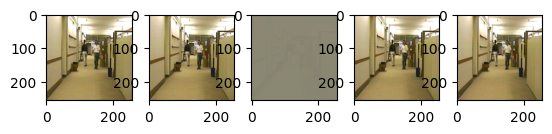

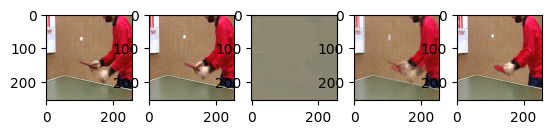

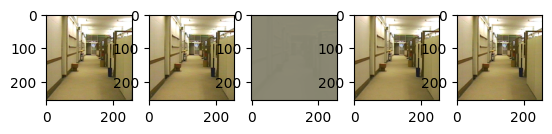

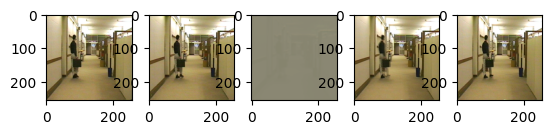

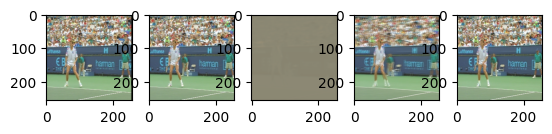

...

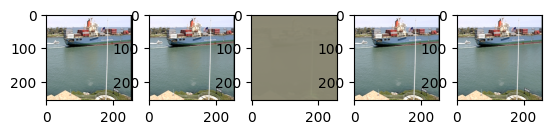

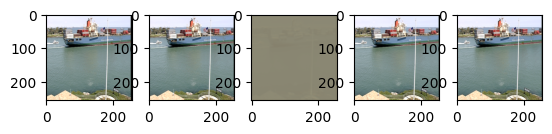

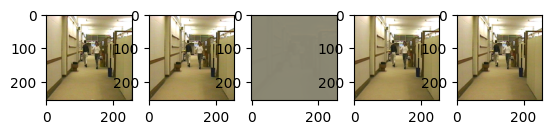

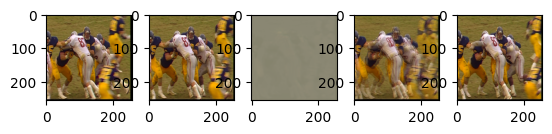

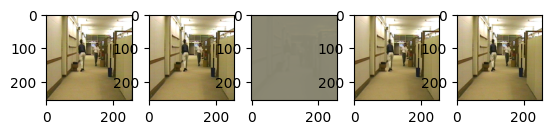

CriticLoss:  tensor(8.1607, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.9339, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6992, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0034, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.1796, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.9431, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7101, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.4586, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.9364, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7049, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0035, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(7.5524, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.8758, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6478, device='cuda:0', grad_fn

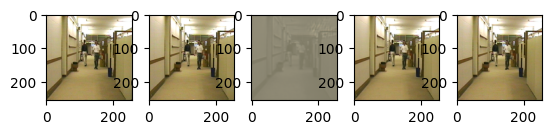

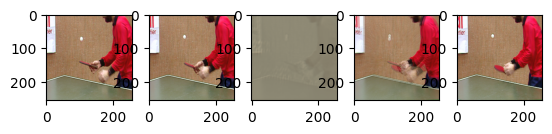

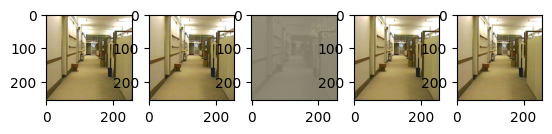

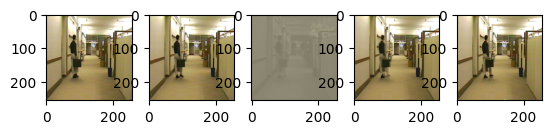

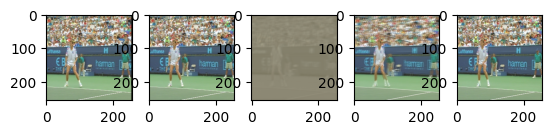

...

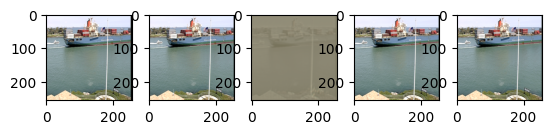

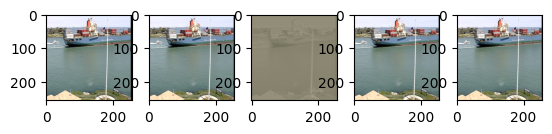

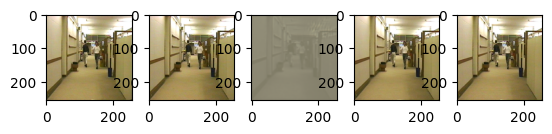

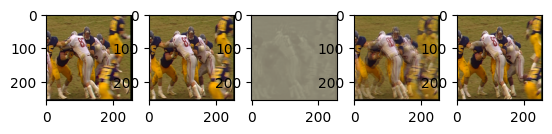

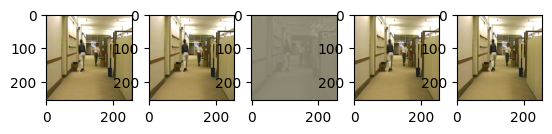

CriticLoss:  tensor(7.7002, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.8379, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6237, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0039, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(7.4861, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.7953, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5937, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(7.6209, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.7027, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5186, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0041, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.2310, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.7528, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5631, device='cuda:0', grad_fn

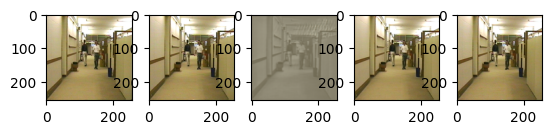

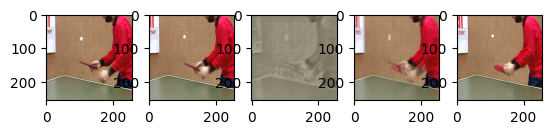

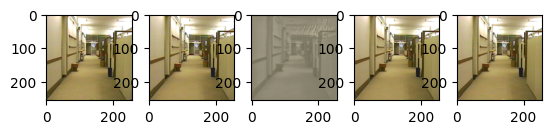

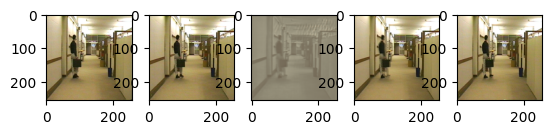

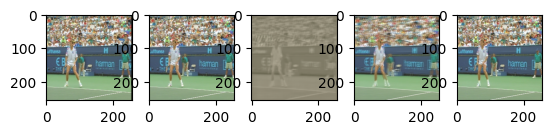

...

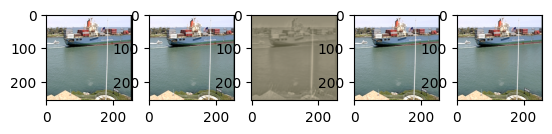

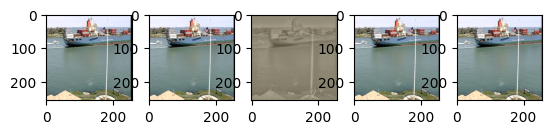

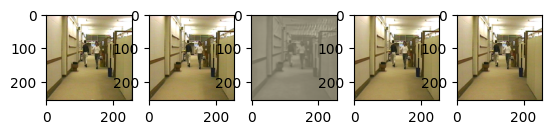

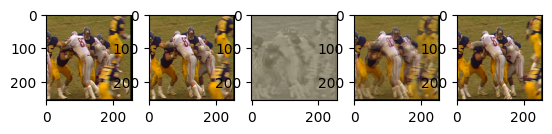

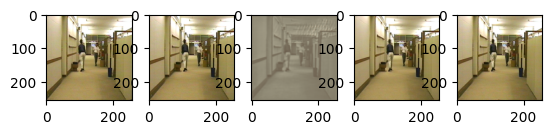

CriticLoss:  tensor(8.3023, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.6014, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4069, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0063, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.2568, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.5452, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3639, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0063, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.1590, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.5480, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3715, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0071, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.2180, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.6089, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4271, device='cuda:0', grad_fn

CriticLoss:  tensor(8.6404, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.4702, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3009, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0116, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [4/32], loss_g: 0.4702, loss_d: 8.6404


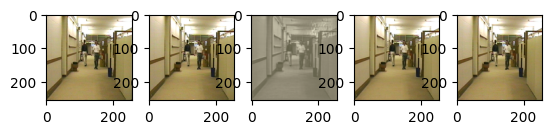

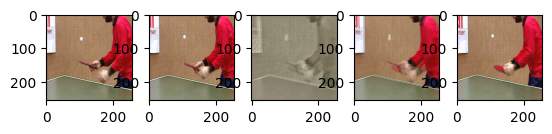

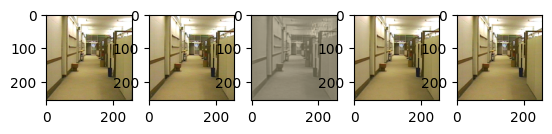

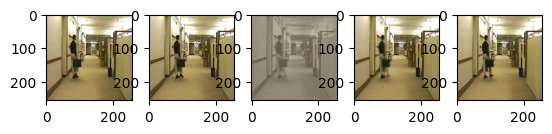

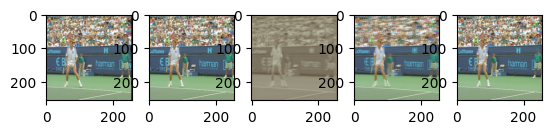

...

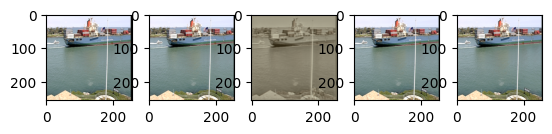

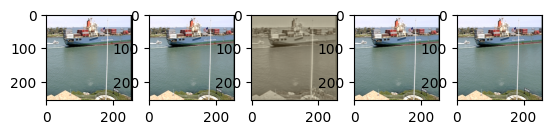

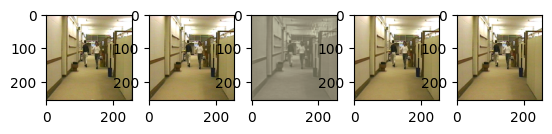

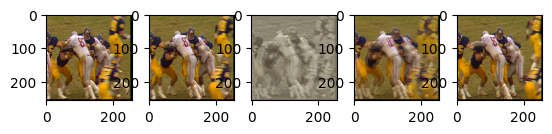

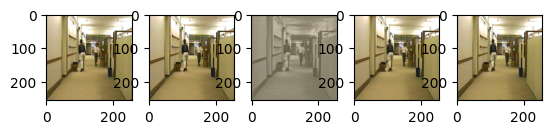

CriticLoss:  tensor(8.4868, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.4171, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2731, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0131, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.5398, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3842, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2394, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0152, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.9046, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3433, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2187, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0145, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(8.8316, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3680, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2387, device='cuda:0', grad_fn

CriticLoss:  tensor(9.2152, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.4602, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3039, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0149, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [5/32], loss_g: 0.4602, loss_d: 9.2152


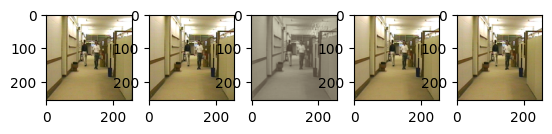

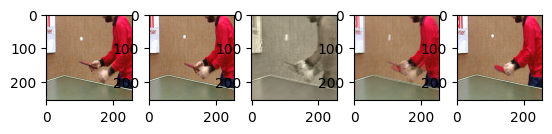

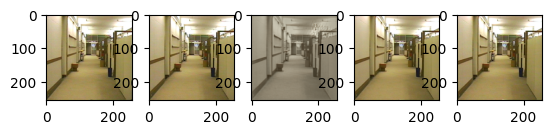

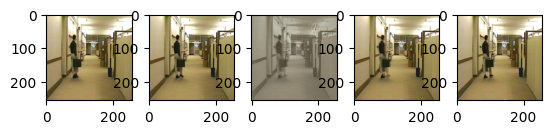

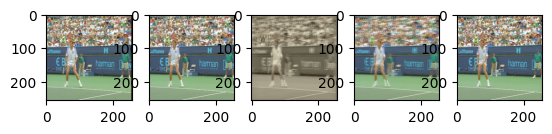

...

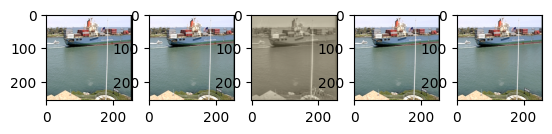

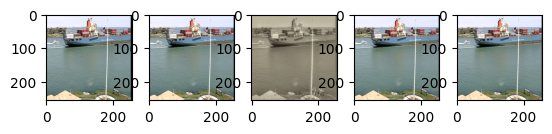

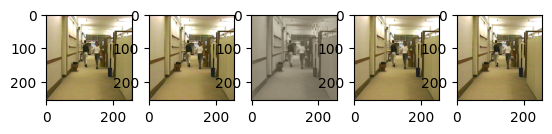

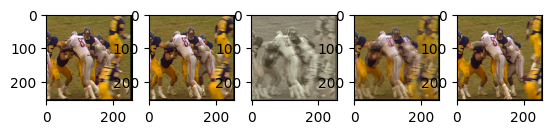

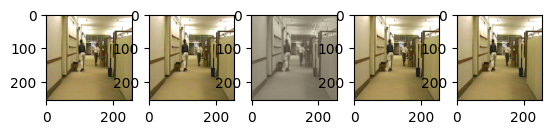

CriticLoss:  tensor(9.0077, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3009, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1933, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.1152, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3550, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2302, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0230, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.2261, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2141, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1205, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0213, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.0475, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3371, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2179, device='cuda:0', grad_fn

CriticLoss:  tensor(9.0813, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3688, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2335, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0273, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [6/32], loss_g: 0.3688, loss_d: 9.0813


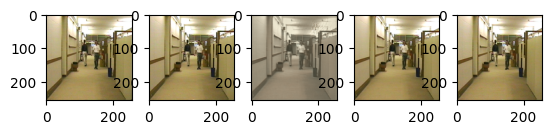

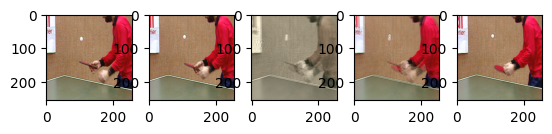

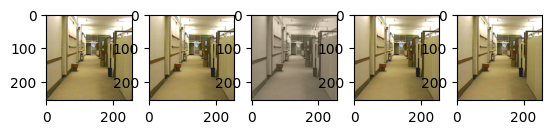

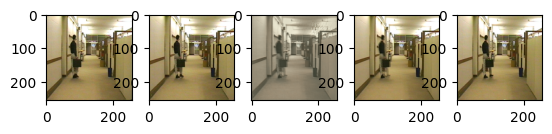

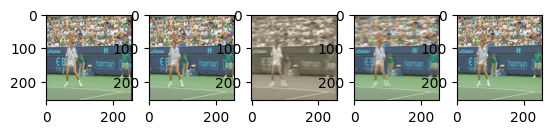

...

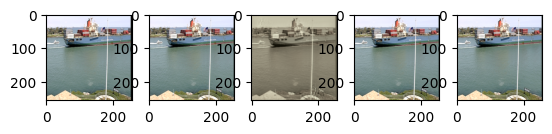

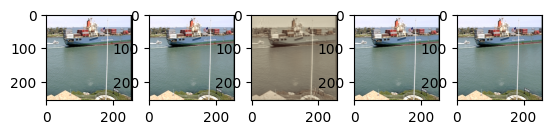

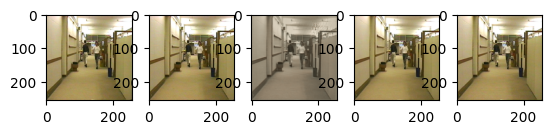

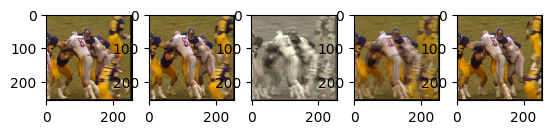

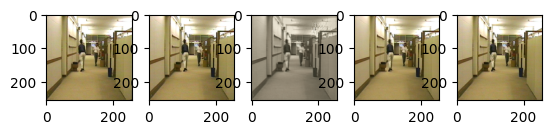

CriticLoss:  tensor(9.3061, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2521, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1731, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0246, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.2584, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1998, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1265, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0278, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.3427, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2784, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1864, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0268, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.3263, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2320, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1515, device='cuda:0', grad_fn

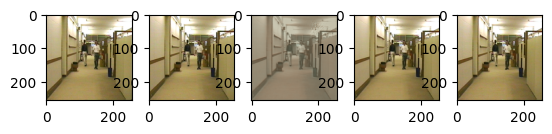

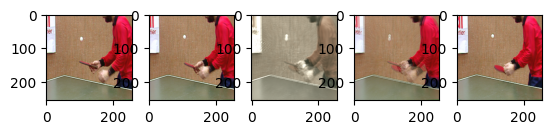

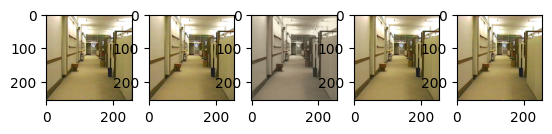

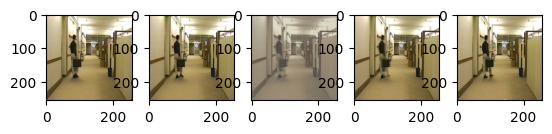

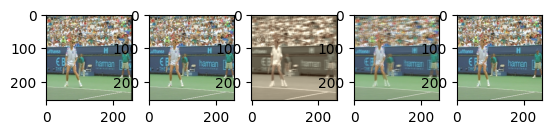

...

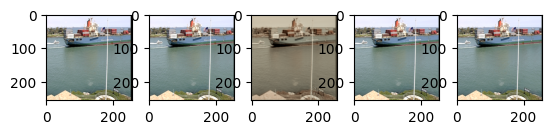

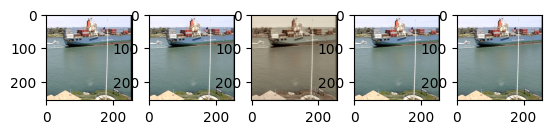

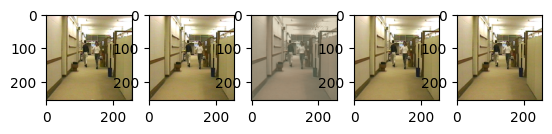

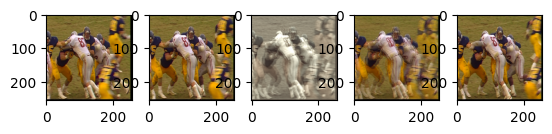

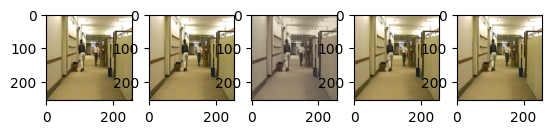

CriticLoss:  tensor(9.5823, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1760, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1216, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0289, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4561, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1535, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1063, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0285, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4350, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3161, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2173, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0275, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.3924, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2214, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1567, device='cuda:0', grad_fn

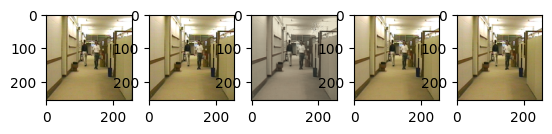

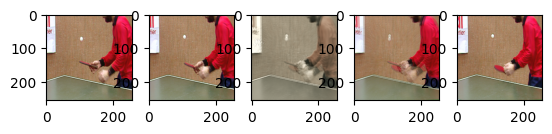

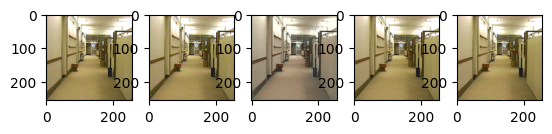

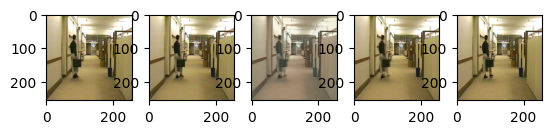

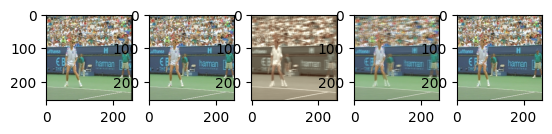

...

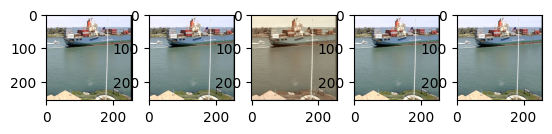

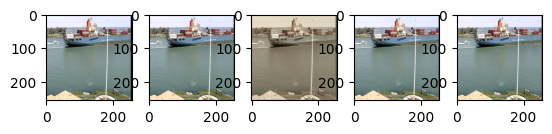

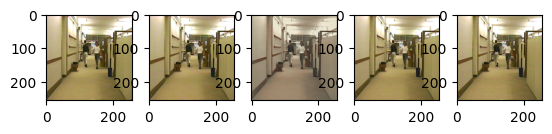

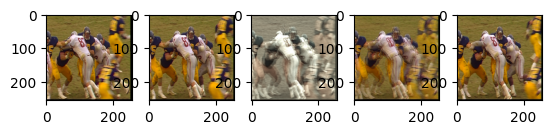

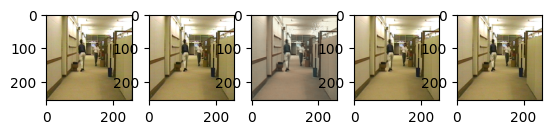

CriticLoss:  tensor(9.2464, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2514, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1765, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0317, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4854, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1551, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1078, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0303, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6320, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1794, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1271, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0304, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4072, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1938, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1335, device='cuda:0', grad_fn

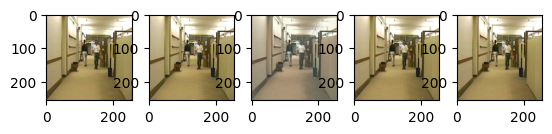

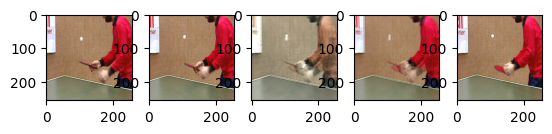

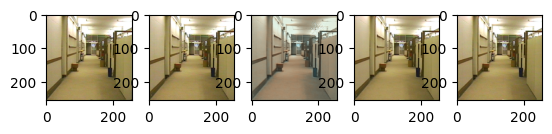

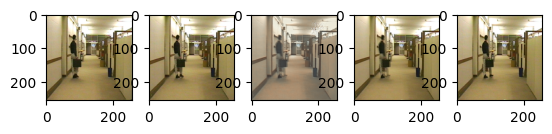

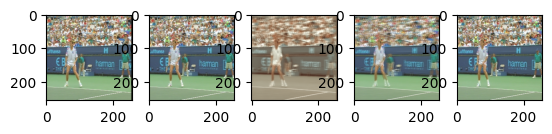

...

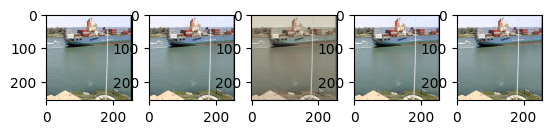

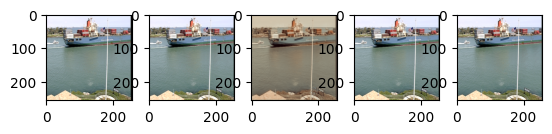

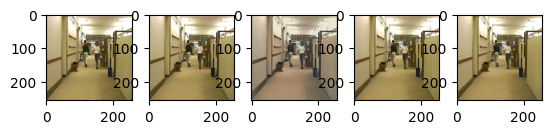

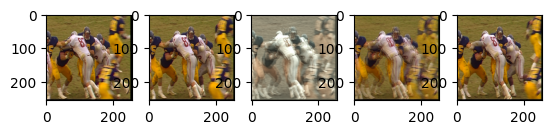

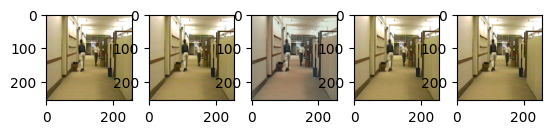

CriticLoss:  tensor(9.5661, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1486, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1078, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0367, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7768, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1743, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1272, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0274, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5822, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1792, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1319, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0364, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7475, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1577, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1074, device='cuda:0', grad_fn

CriticLoss:  tensor(9.1589, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.5520, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3321, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0274, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [10/32], loss_g: 0.5520, loss_d: 9.1589


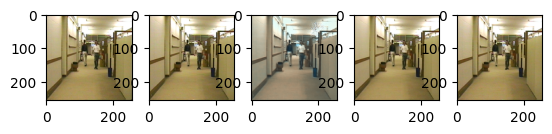

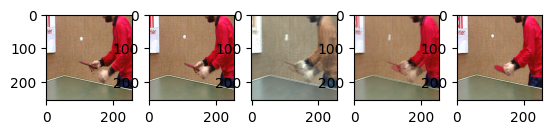

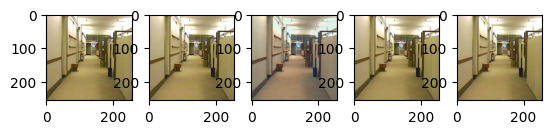

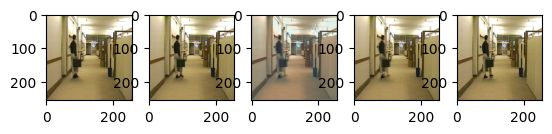

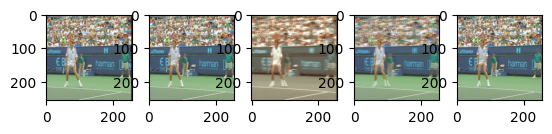

...

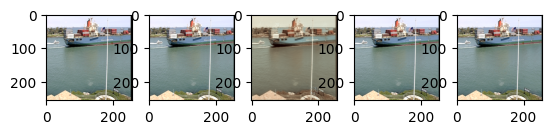

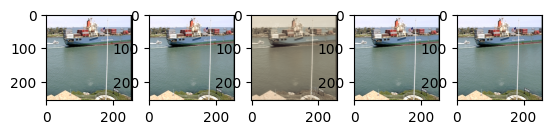

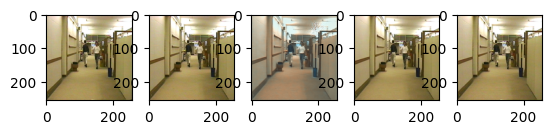

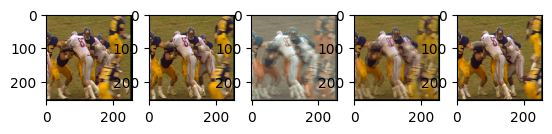

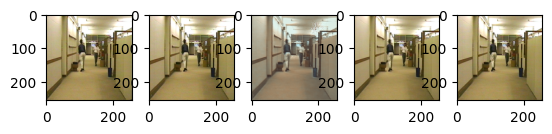

CriticLoss:  tensor(9.6046, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2289, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1731, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0348, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6641, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1558, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1158, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0364, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5112, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1926, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1426, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0267, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7665, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1673, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1275, device='cuda:0', grad_fn

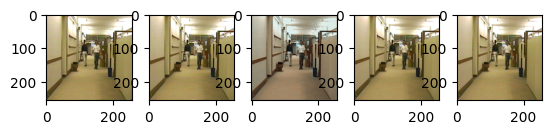

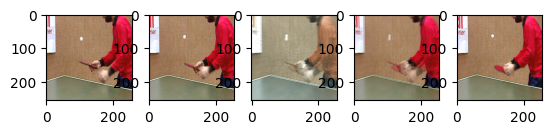

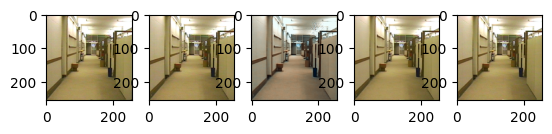

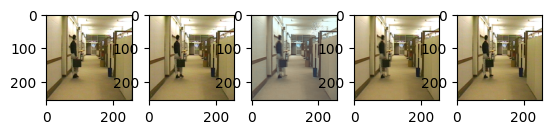

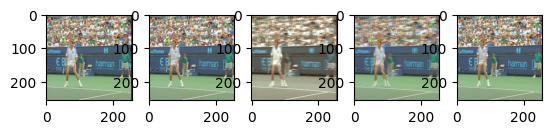

...

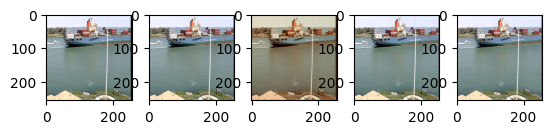

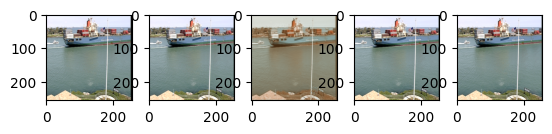

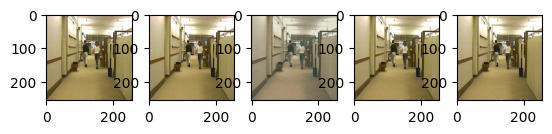

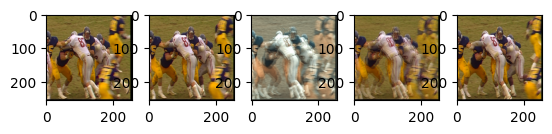

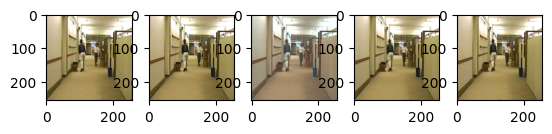

CriticLoss:  tensor(9.4065, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1687, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1237, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0444, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5396, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1215, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0938, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0433, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4997, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1825, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1275, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0453, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6398, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2222, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1547, device='cuda:0', grad_fn

CriticLoss:  tensor(9.0381, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1380, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1113, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0335, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [12/32], loss_g: 0.1380, loss_d: 9.0381


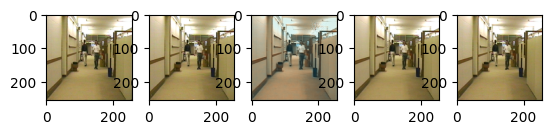

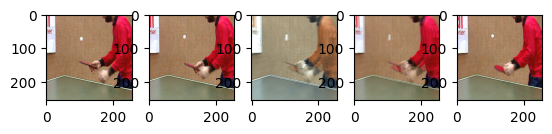

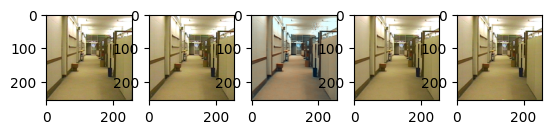

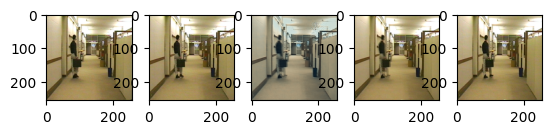

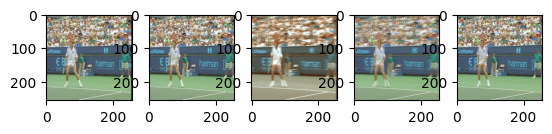

...

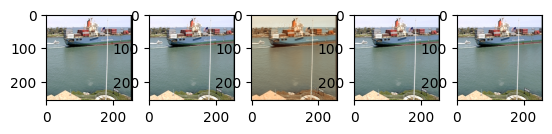

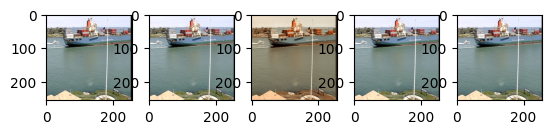

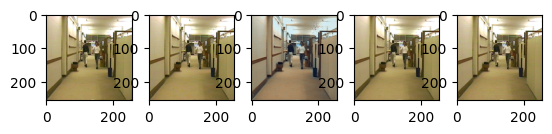

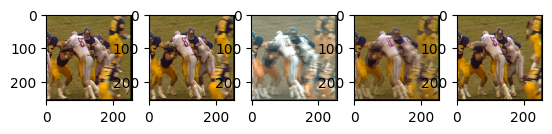

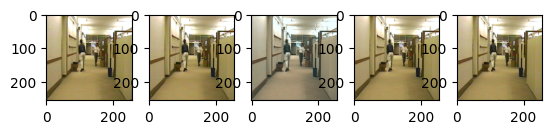

CriticLoss:  tensor(9.5589, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1334, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1055, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0352, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6389, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2646, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1861, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0330, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6808, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1044, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0873, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0379, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6248, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0870, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0730, device='cuda:0', grad_fn

CriticLoss:  tensor(9.7153, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1190, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0952, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0556, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [13/32], loss_g: 0.1190, loss_d: 9.7153


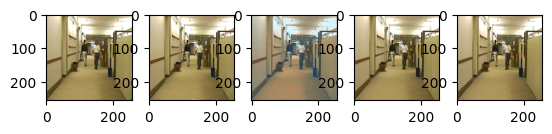

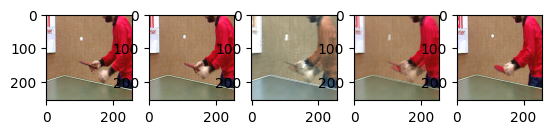

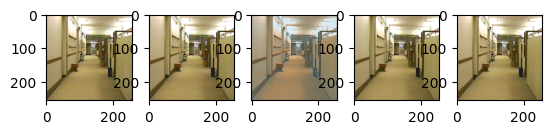

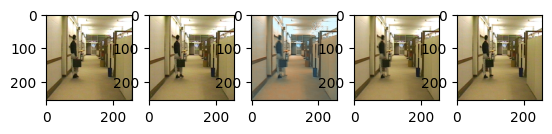

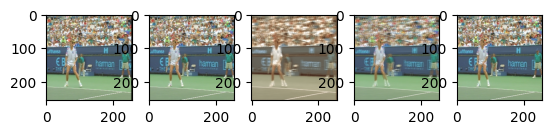

...

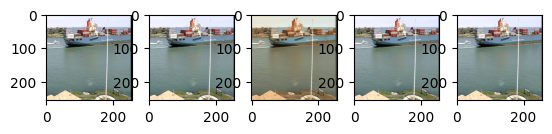

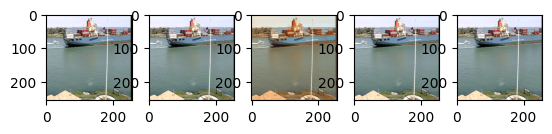

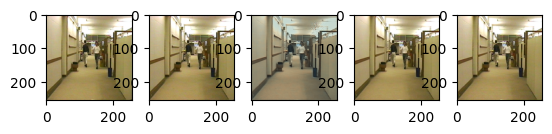

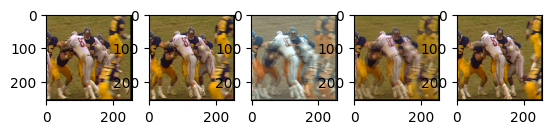

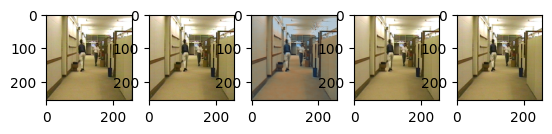

CriticLoss:  tensor(9.7599, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2144, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1651, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0389, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7392, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1371, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1205, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0368, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6538, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2204, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1622, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0326, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6759, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1062, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0849, device='cuda:0', grad_fn

CriticLoss:  tensor(9.5513, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.4026, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1974, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0396, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [14/32], loss_g: 0.4026, loss_d: 9.5513


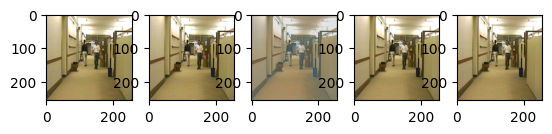

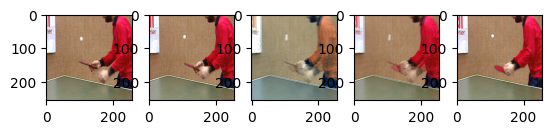

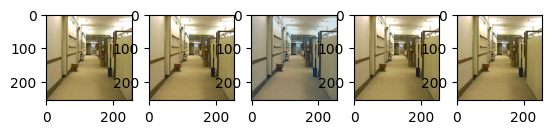

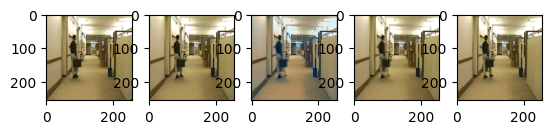

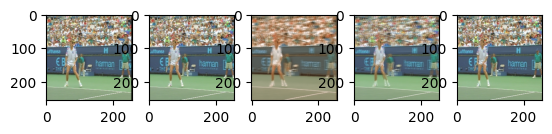

...

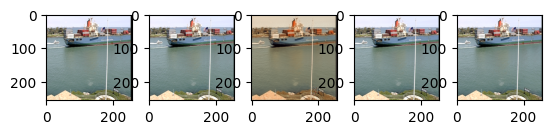

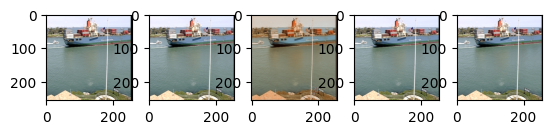

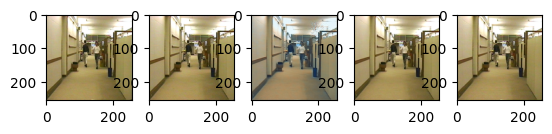

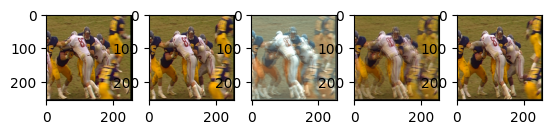

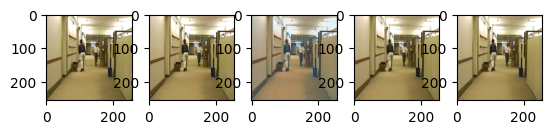

CriticLoss:  tensor(9.6349, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2499, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1896, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0370, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6024, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1954, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1504, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0347, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4882, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1602, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1214, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0386, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5463, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2028, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1475, device='cuda:0', grad_fn

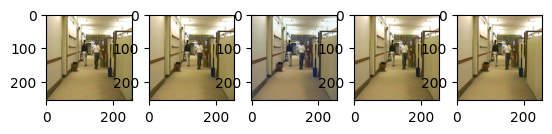

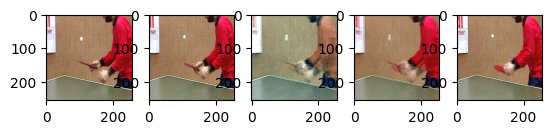

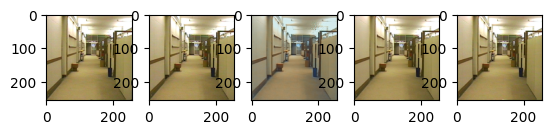

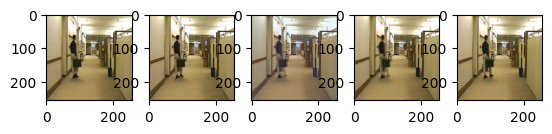

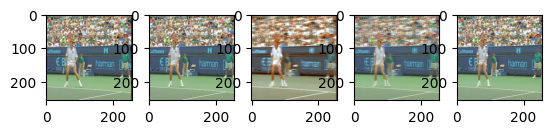

...

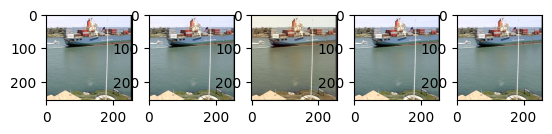

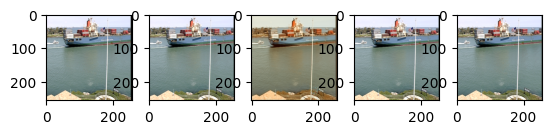

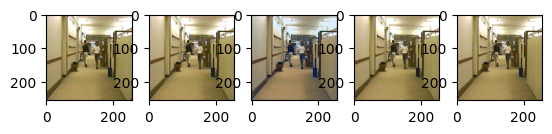

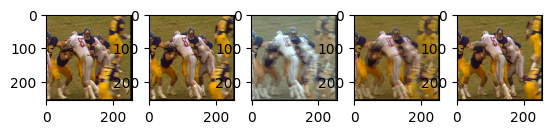

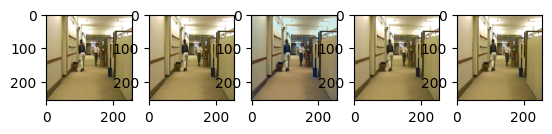

CriticLoss:  tensor(9.3956, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1227, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1001, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0441, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5406, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1735, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1276, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0422, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6599, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1733, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1256, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0533, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5429, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1443, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1134, device='cuda:0', grad_fn

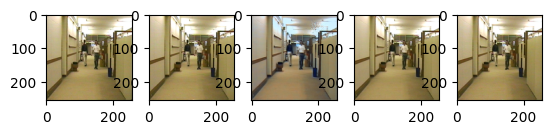

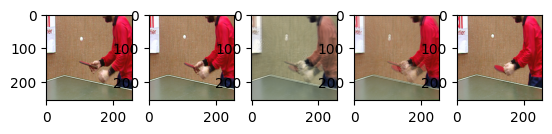

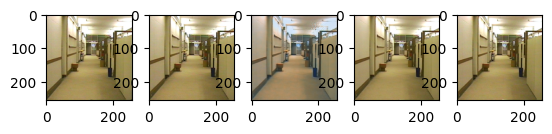

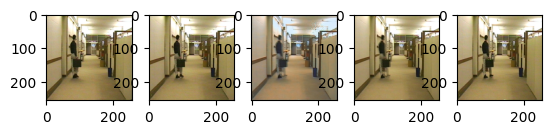

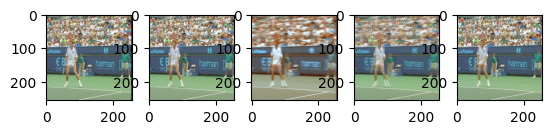

...

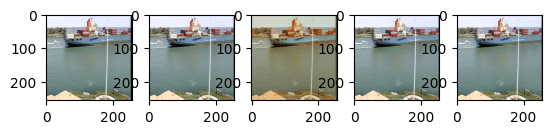

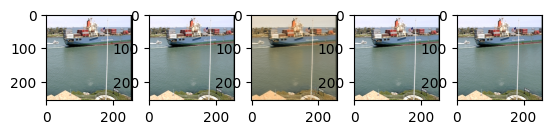

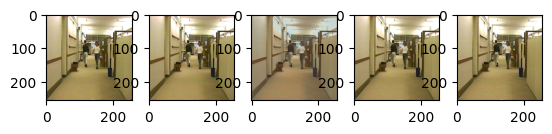

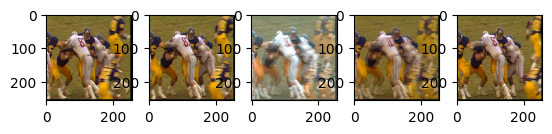

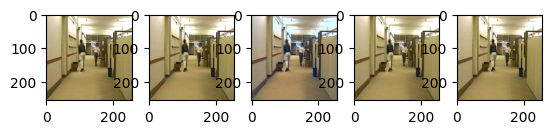

CriticLoss:  tensor(9.5320, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0984, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0750, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0473, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7126, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2100, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1684, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0415, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6184, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0977, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0785, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0453, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.8071, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1022, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0930, device='cuda:0', grad_fn

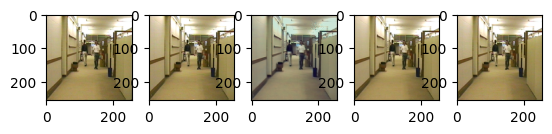

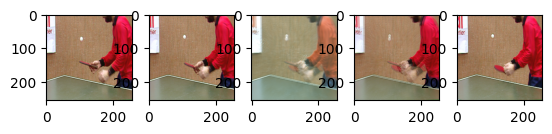

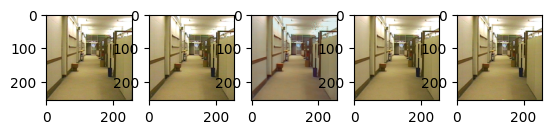

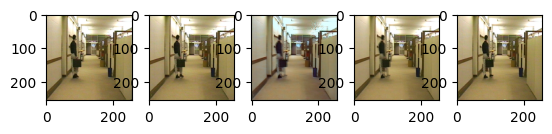

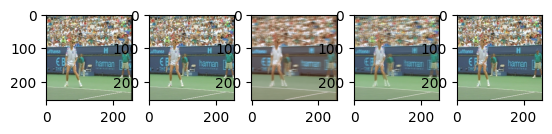

...

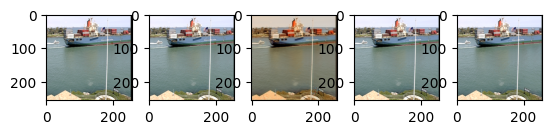

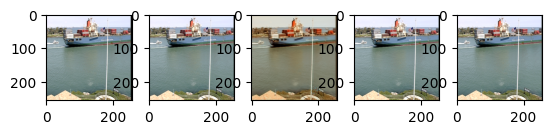

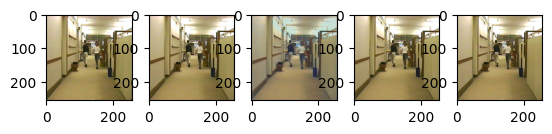

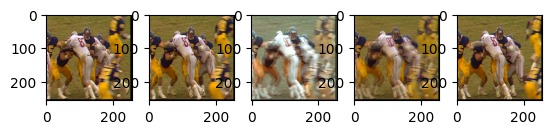

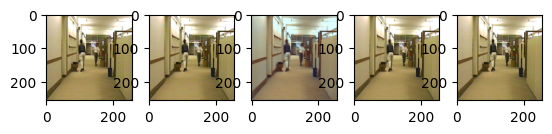

CriticLoss:  tensor(9.5709, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0798, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0716, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0471, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5588, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2434, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1789, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0501, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6318, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1281, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1051, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0409, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7839, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1973, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1640, device='cuda:0', grad_fn

CriticLoss:  tensor(9.7744, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1746, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1339, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0381, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [18/32], loss_g: 0.1746, loss_d: 9.7744


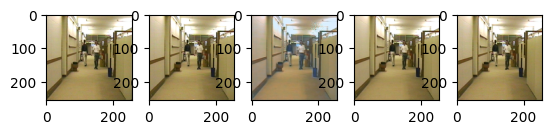

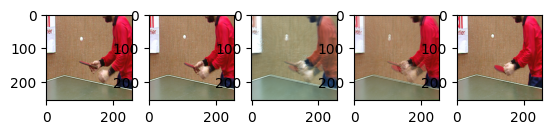

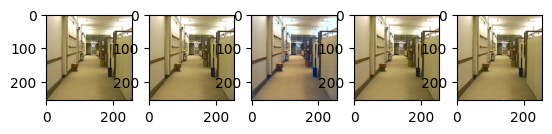

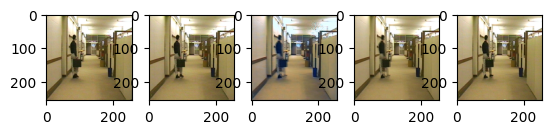

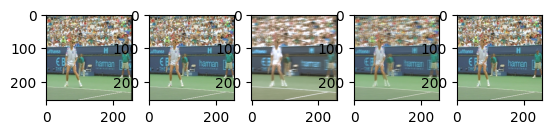

...

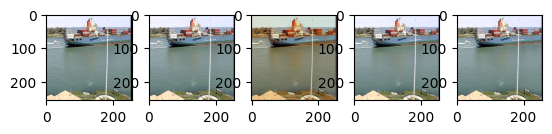

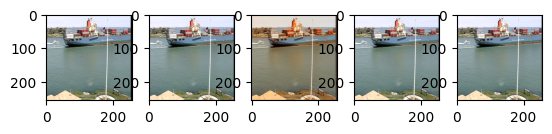

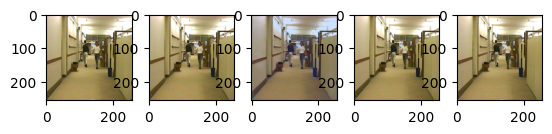

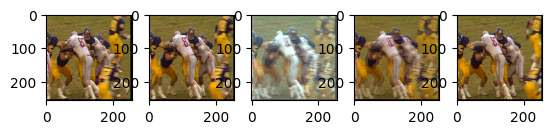

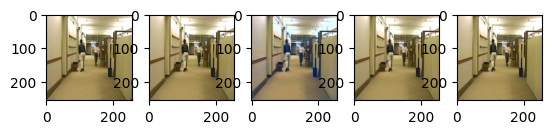

CriticLoss:  tensor(9.6169, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2060, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1656, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0449, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5989, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1668, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1297, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0426, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6846, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1670, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1341, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0389, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5569, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1048, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0862, device='cuda:0', grad_fn

CriticLoss:  tensor(9.8091, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0448, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0355, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0662, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [19/32], loss_g: 0.0448, loss_d: 9.8091


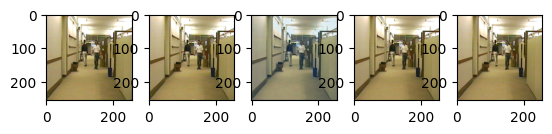

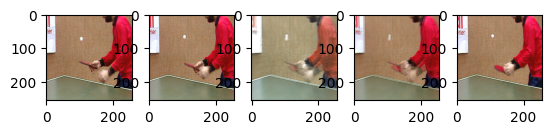

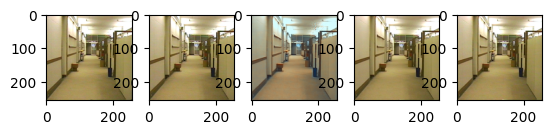

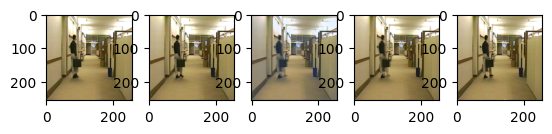

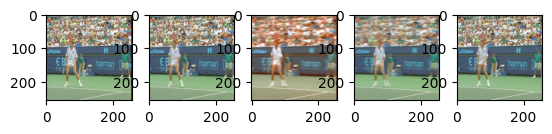

...

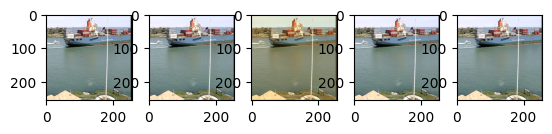

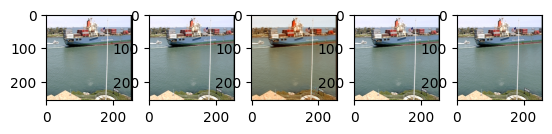

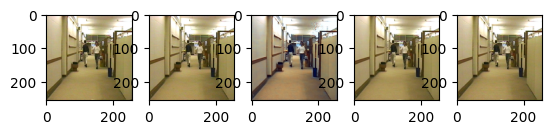

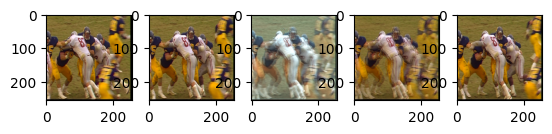

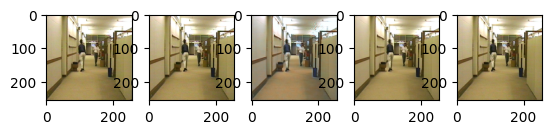

CriticLoss:  tensor(9.5399, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1189, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0928, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0544, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6614, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0498, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0595, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0455, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7638, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0924, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0825, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0449, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7356, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2182, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1659, device='cuda:0', grad_fn

CriticLoss:  tensor(9.9130, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0877, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0741, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0489, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [20/32], loss_g: 0.0877, loss_d: 9.9130


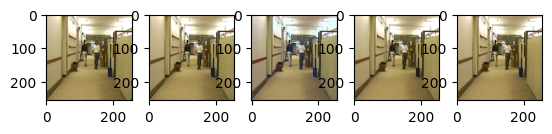

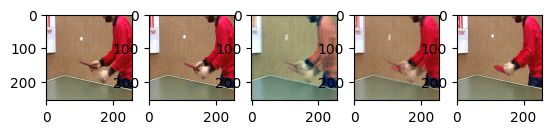

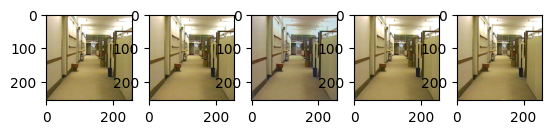

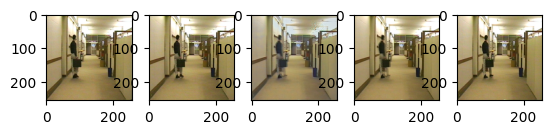

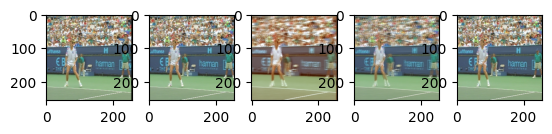

...

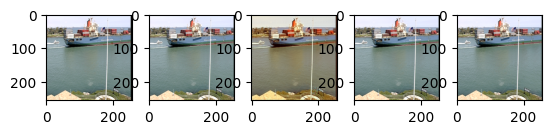

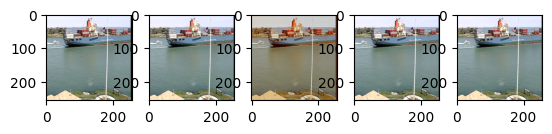

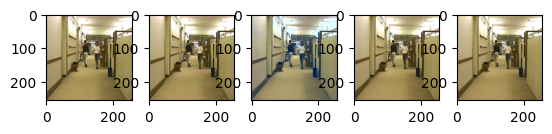

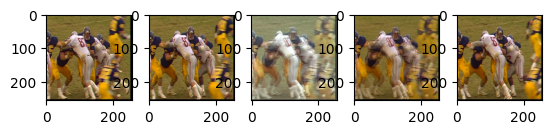

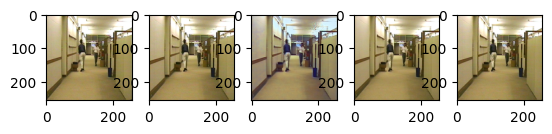

CriticLoss:  tensor(9.7568, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3108, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2333, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0415, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7459, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1303, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1030, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0379, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7106, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1243, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1054, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0448, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5617, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1190, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1056, device='cuda:0', grad_fn

CriticLoss:  tensor(9.5180, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3180, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2231, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0378, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [21/32], loss_g: 0.3180, loss_d: 9.5180


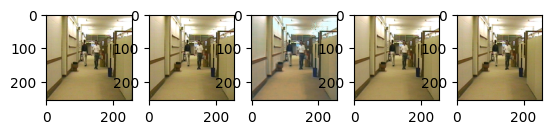

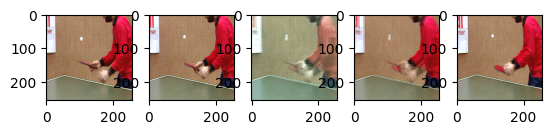

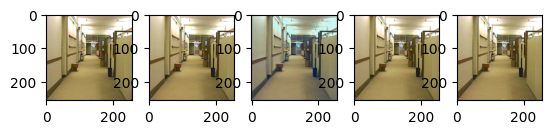

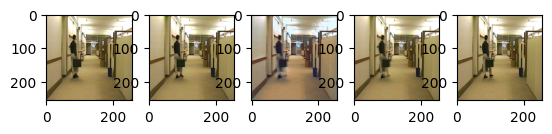

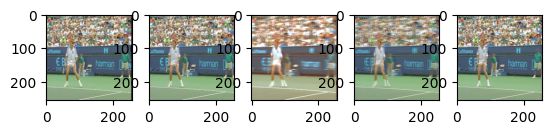

...

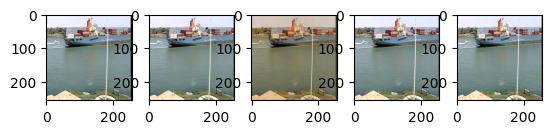

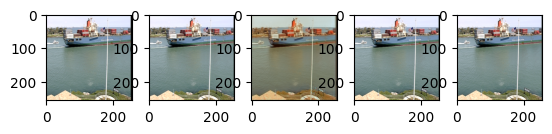

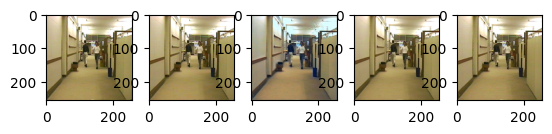

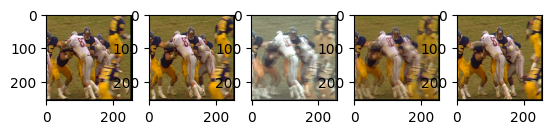

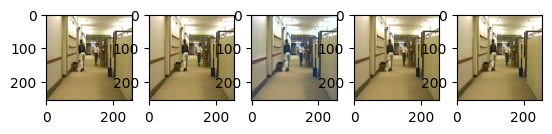

CriticLoss:  tensor(9.7383, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1025, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0891, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0430, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7974, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2670, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1963, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0385, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5605, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1405, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1103, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0461, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6884, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1538, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1240, device='cuda:0', grad_fn

CriticLoss:  tensor(9.6912, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1035, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0842, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0501, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [22/32], loss_g: 0.1035, loss_d: 9.6912


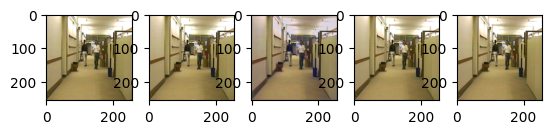

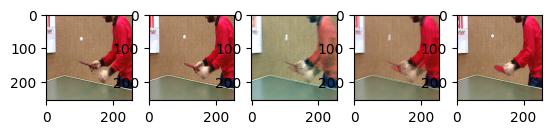

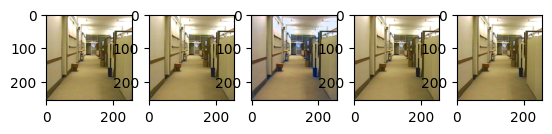

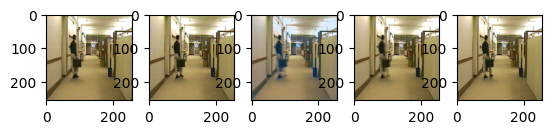

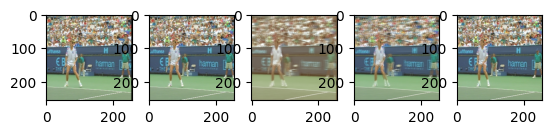

...

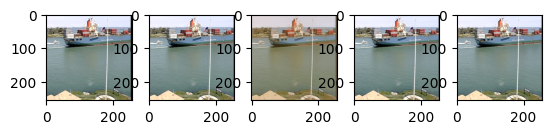

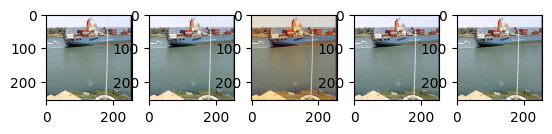

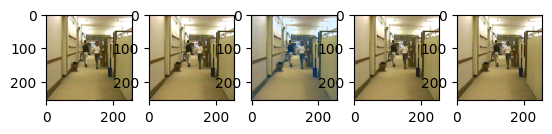

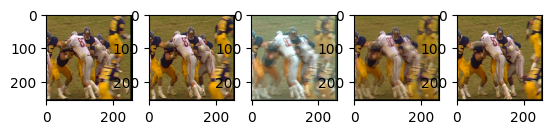

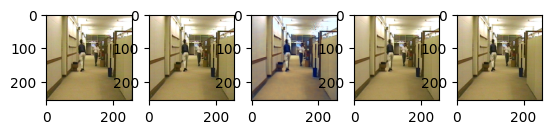

CriticLoss:  tensor(9.5671, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1420, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1204, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0478, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7394, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0756, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0660, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0389, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7539, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1181, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0975, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0484, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6796, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1580, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1223, device='cuda:0', grad_fn

CriticLoss:  tensor(9.8810, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1160, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0987, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0472, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [23/32], loss_g: 0.1160, loss_d: 9.8810


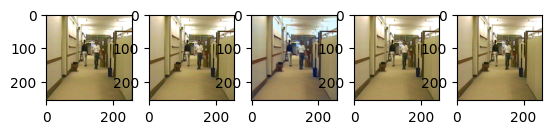

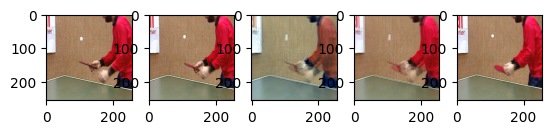

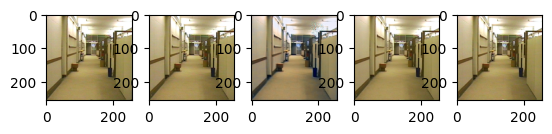

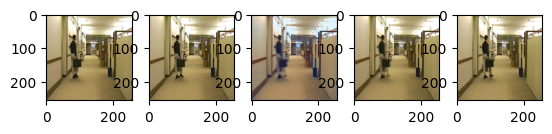

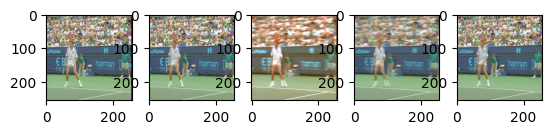

...

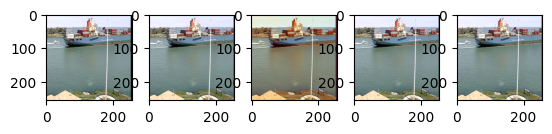

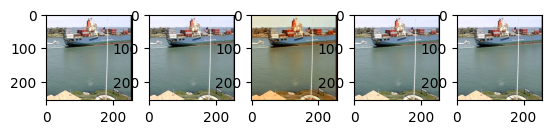

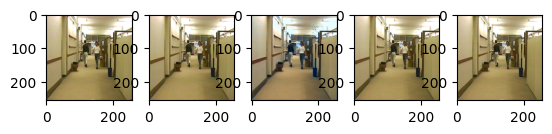

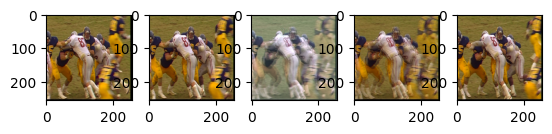

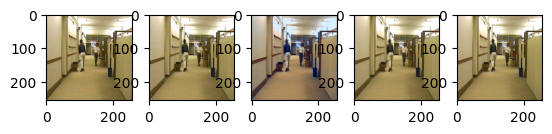

CriticLoss:  tensor(9.6353, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2272, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1665, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0459, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7776, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0459, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0572, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0482, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7447, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1761, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1405, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0523, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7475, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1561, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1282, device='cuda:0', grad_fn

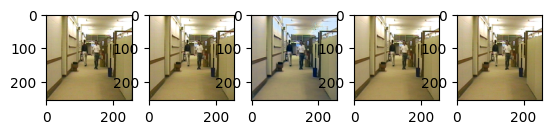

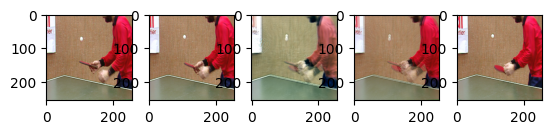

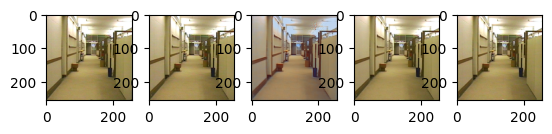

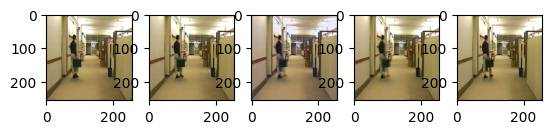

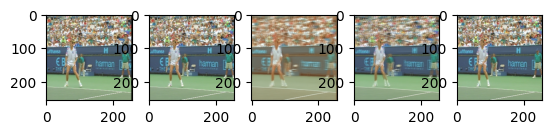

...

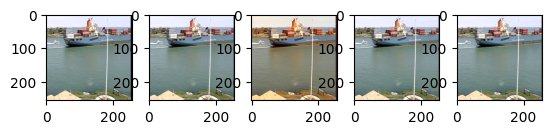

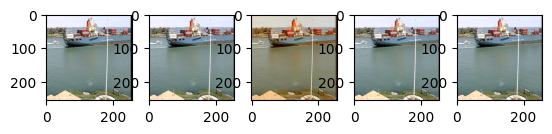

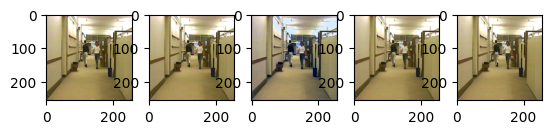

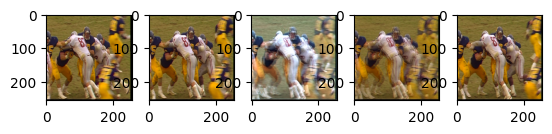

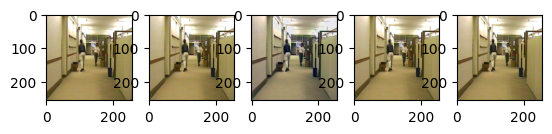

CriticLoss:  tensor(9.6792, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1118, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0919, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0526, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6240, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0917, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0831, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0496, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6773, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0888, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0790, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0481, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7036, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0986, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0871, device='cuda:0', grad_fn

CriticLoss:  tensor(9.9056, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0425, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0344, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0598, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [25/32], loss_g: 0.0425, loss_d: 9.9056


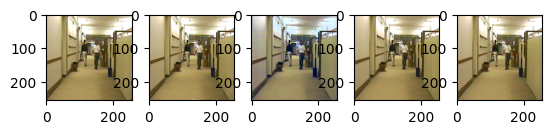

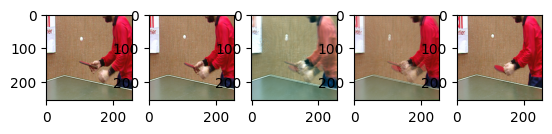

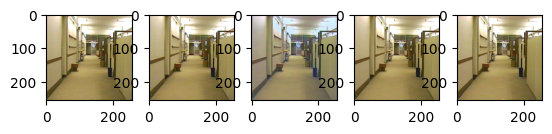

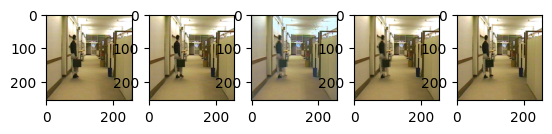

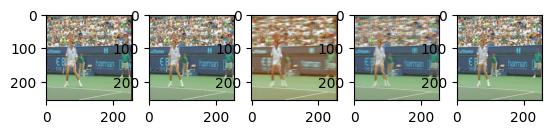

...

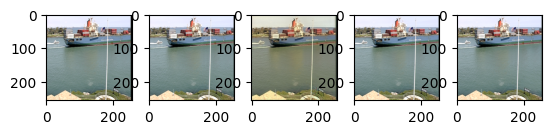

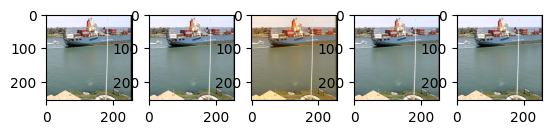

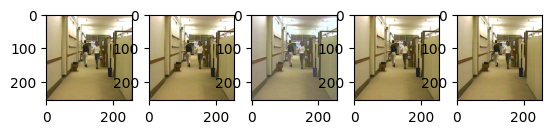

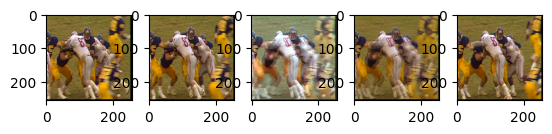

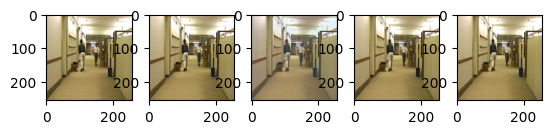

CriticLoss:  tensor(9.7365, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1428, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1177, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0492, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5435, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1618, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1281, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0441, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.8033, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1639, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1319, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0472, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6716, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1152, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0997, device='cuda:0', grad_fn

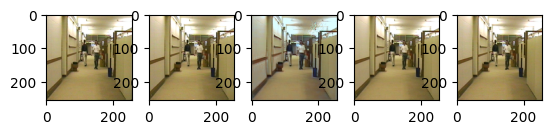

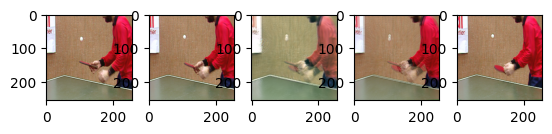

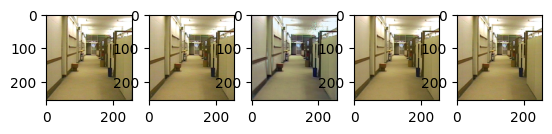

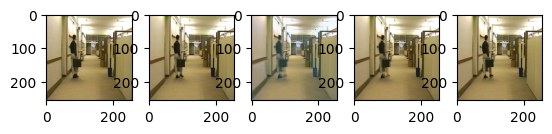

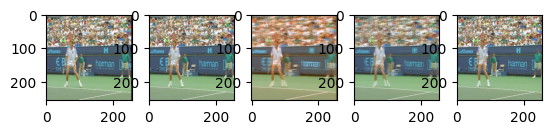

...

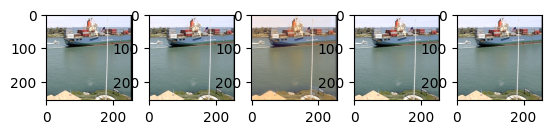

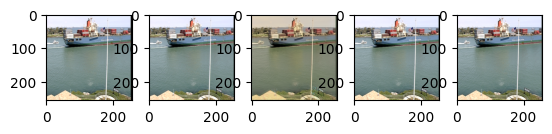

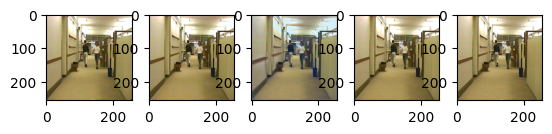

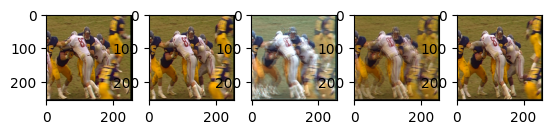

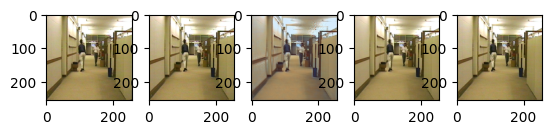

CriticLoss:  tensor(9.7538, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0898, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0789, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0460, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6802, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1310, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1016, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0514, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5412, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1116, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0869, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0481, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6020, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1258, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0994, device='cuda:0', grad_fn

CriticLoss:  tensor(9.8274, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0824, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0665, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0596, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [27/32], loss_g: 0.0824, loss_d: 9.8274


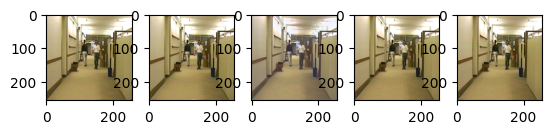

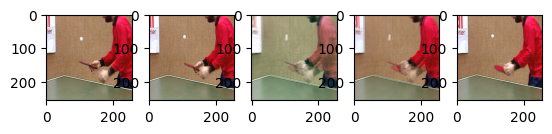

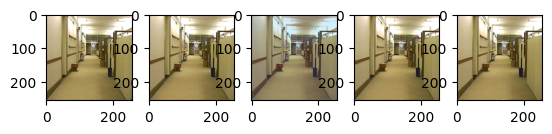

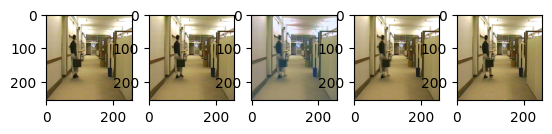

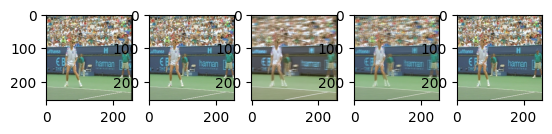

...

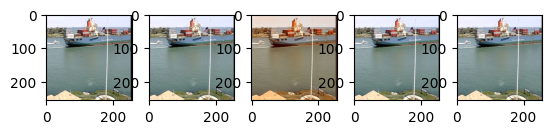

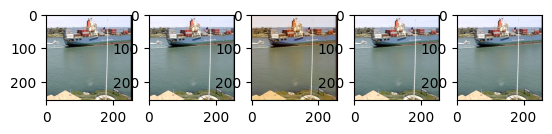

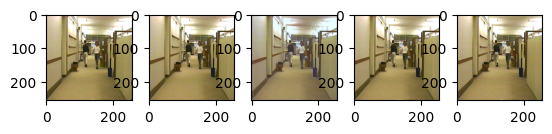

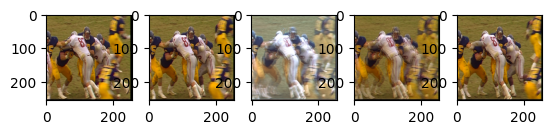

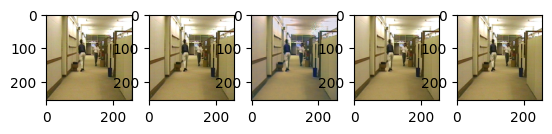

CriticLoss:  tensor(9.6439, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1592, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1291, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0442, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6598, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1410, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1133, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0591, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5256, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1049, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0869, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0593, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6523, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1645, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1374, device='cuda:0', grad_fn

CriticLoss:  tensor(9.5217, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.2525, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1566, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0400, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [28/32], loss_g: 0.2525, loss_d: 9.5217


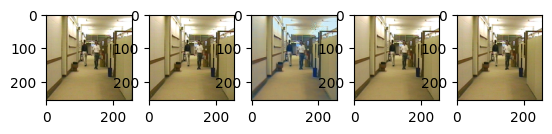

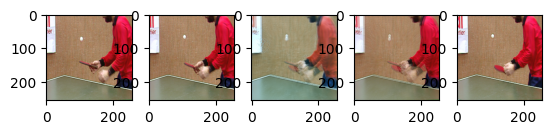

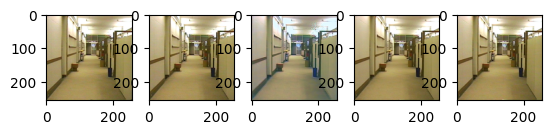

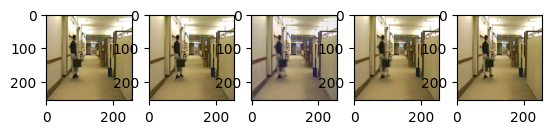

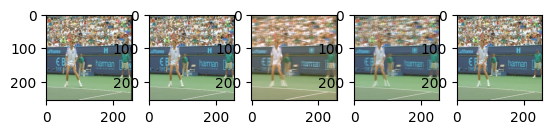

...

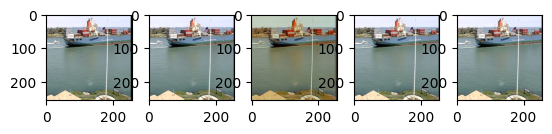

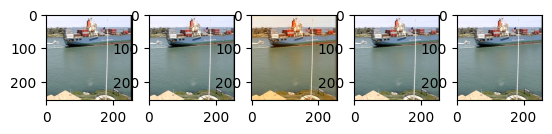

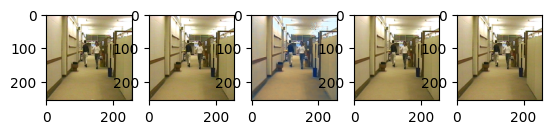

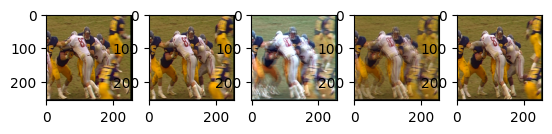

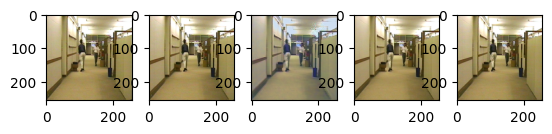

CriticLoss:  tensor(9.5655, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0395, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0489, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0453, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.4548, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1313, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1150, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0435, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5123, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1707, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1277, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0397, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5361, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1755, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1241, device='cuda:0', grad_fn

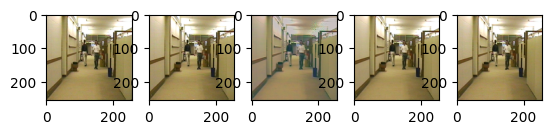

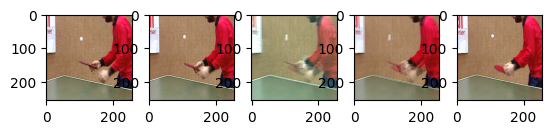

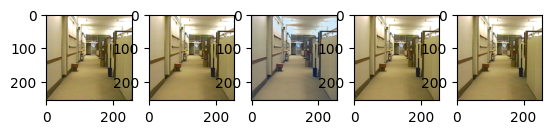

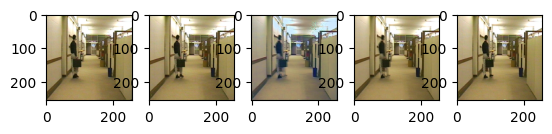

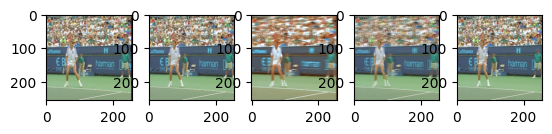

...

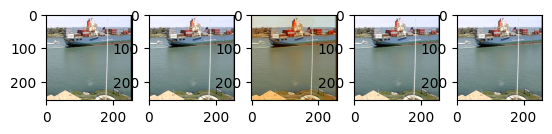

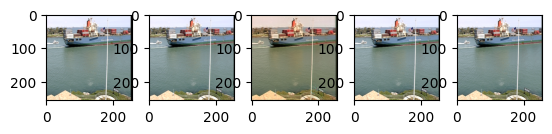

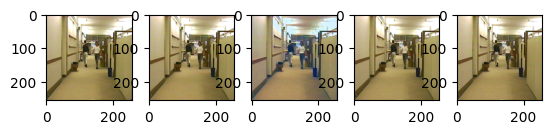

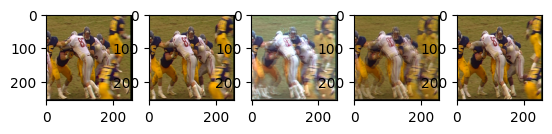

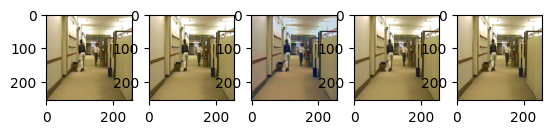

CriticLoss:  tensor(9.7228, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0920, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0799, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0476, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6716, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1673, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1384, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0396, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7440, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1254, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1070, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0402, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7952, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0661, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0648, device='cuda:0', grad_fn

CriticLoss:  tensor(9.3235, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.3238, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1969, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0363, device='cuda:0', grad_fn=<MseLossBackward0>)
Epoch [30/32], loss_g: 0.3238, loss_d: 9.3235


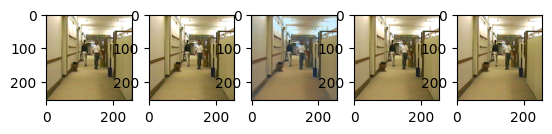

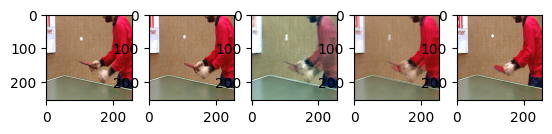

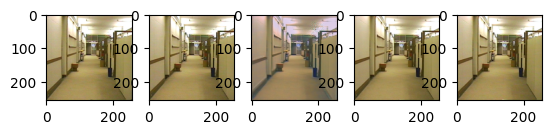

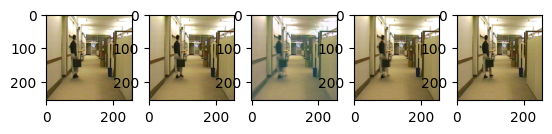

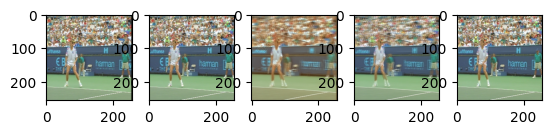

...

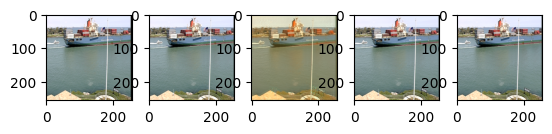

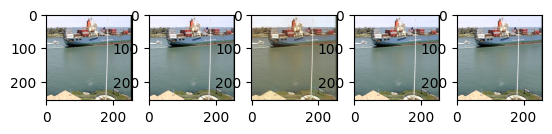

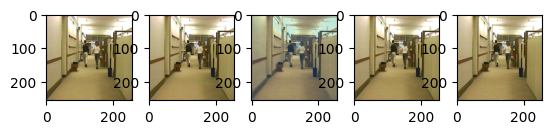

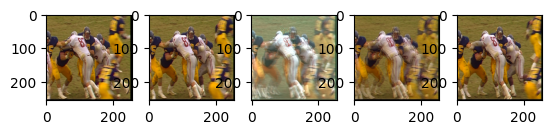

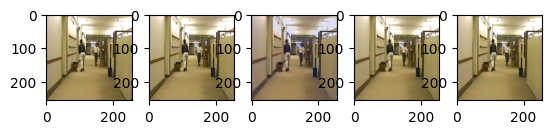

CriticLoss:  tensor(9.6082, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1211, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1023, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0497, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.8391, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1954, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1557, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0471, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6952, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1284, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1106, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0487, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.7275, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1145, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0923, device='cuda:0', grad_fn

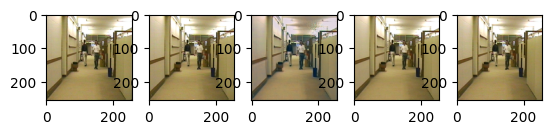

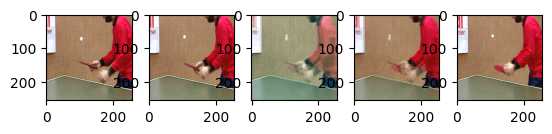

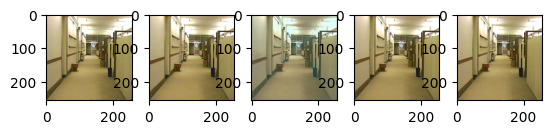

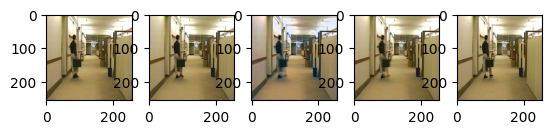

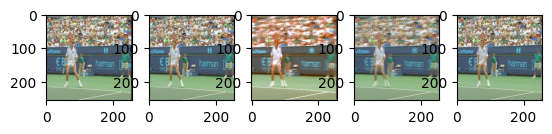

...

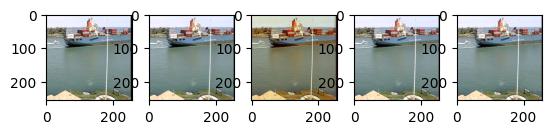

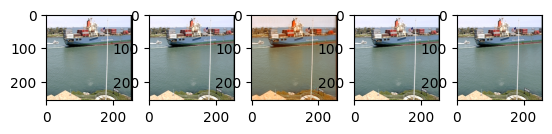

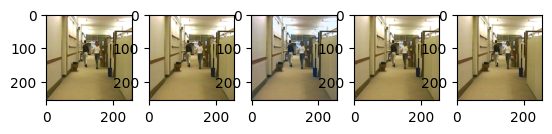

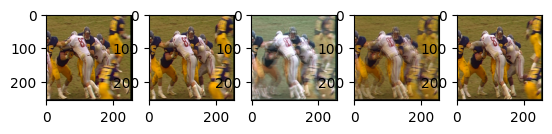

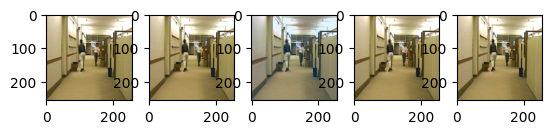

CriticLoss:  tensor(9.5249, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1005, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0823, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0509, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.3474, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1137, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0953, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0461, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.6046, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.1233, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.1075, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0502, device='cuda:0', grad_fn=<MseLossBackward0>)
CriticLoss:  tensor(9.5546, device='cuda:0', grad_fn=<AddBackward0>)
TotalGEN_LOSS= tensor(0.0541, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.0576, device='cuda:0', grad_fn

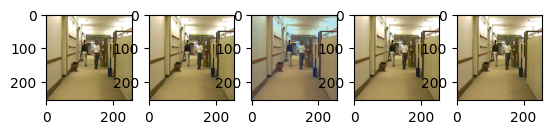

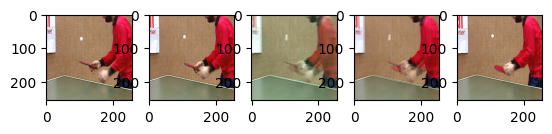

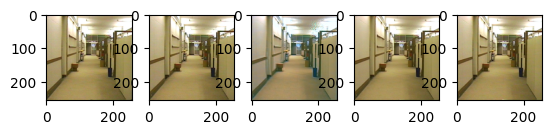

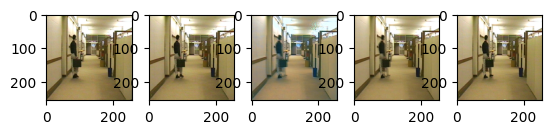

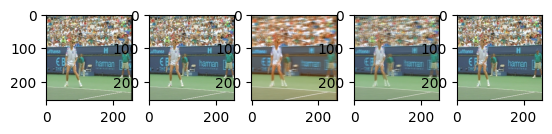

...

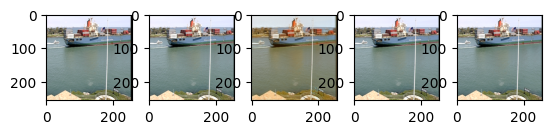

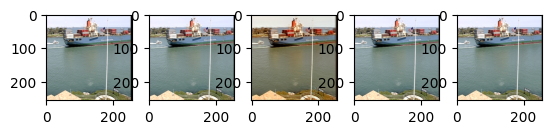

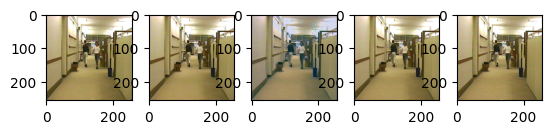

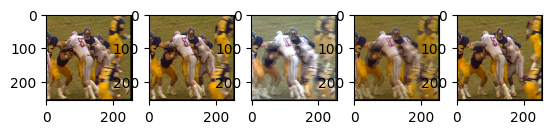

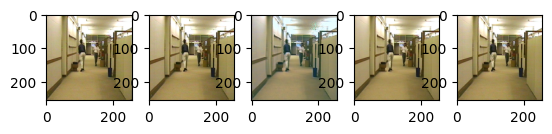

In [12]:
lossG, lossD = train(Num_Epochs,Lr)

In [13]:
torch.save(gen.state_dict(),'/content/FiNNiGAN-Implementation/logs/WGenerator.pth')
torch.save(critic.state_dict(),'/content/FiNNiGAN-Implementation/logs/WCritic.pth')

[]

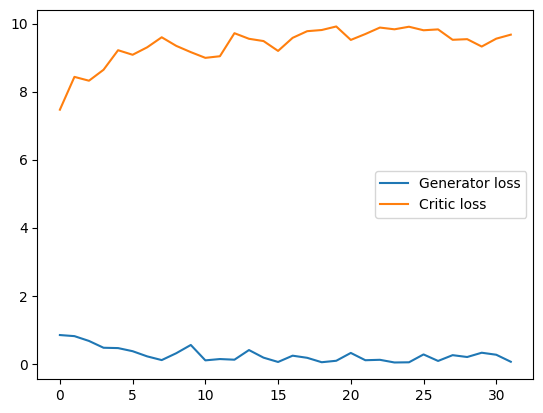

In [15]:
plt.plot(lossG,label='Generator loss')
plt.plot(lossD,label='Critic loss')
plt.legend()
plt.plot()

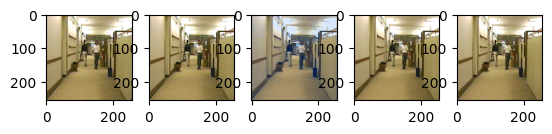

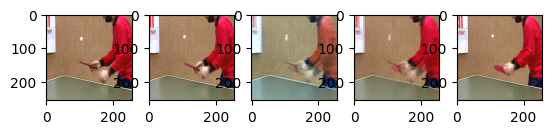

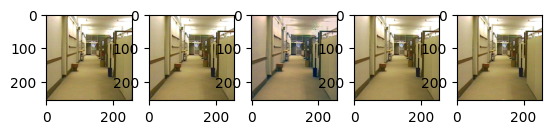

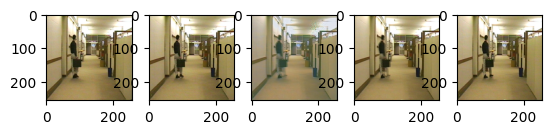

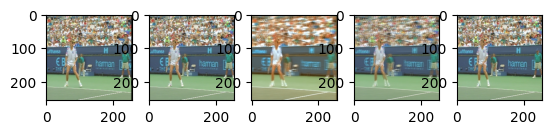

...

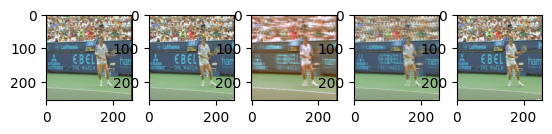

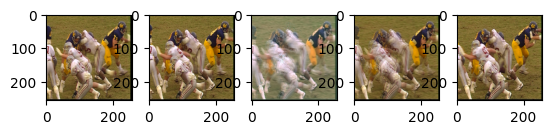

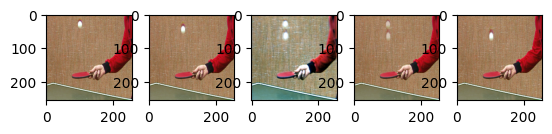

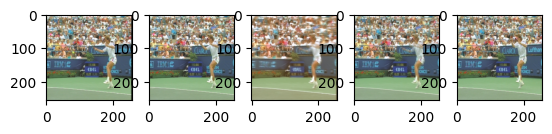

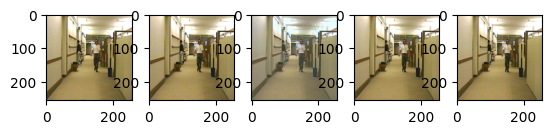

In [18]:
def showImgTEST(idx):
    t1,t2,Img1,Img2 = test_set[idx]
    t1.to(device)
    t2.to(device)
    Img1.to(device)
    Img2.to(device)
    T1 = torch.unsqueeze(t1,dim=0).to(device)
    genout = gen(T1).to(device)
    genout = torch.squeeze(genout,dim=0).to(device)
    f , axarr = plt.subplots(1,5)
    axarr[0].imshow(denorm(Img1).permute(1,2,0),label='FRAME1')
    axarr[1].imshow(denorm(t2).permute(1,2,0),label='FRAME2')
    with torch.no_grad():
        axarr[2].imshow(denorm(genout.to('cpu')).permute(1,2,0),label='GENERATED')
    axarr[3].imshow(denorm(t1).permute(1,2,0),label='INPUT TO GEN')
    axarr[4].imshow(denorm(Img2).permute(1,2,0),label='FRAME3')
    f.show()
    plt.show(block=True)

for i in range(int(len(test_set))):
    showImgTEST(i)


# FRAME1--FRAME2--GENERATED--INPUT_TO_GEN--FRAME3